In [1]:
# Workaround to use src modules
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

In [2]:
# Library imports
import imageio
import numpy as np
import matplotlib.pyplot as plt

from skimage import filters
from skimage.color import rgb2lab, lab2rgb
from skimage.segmentation import slic, mark_boundaries
from skimage.measure import regionprops
from scipy.stats import mode

from sklearn.cluster import KMeans
from scipy.ndimage import convolve
from scipy.ndimage import gaussian_filter


# Functions Imports
from src.utils import image_to_grayscale, image_minmax_norm, load_image, image_downsampling
from src.quantization import image_bitshift, palette_kmeans
from src.segmentation import threshold_segmentation, otsu_segmentation, labels_to_edges, labels_to_edges_thin
from src.visualizations import visualize_bitshift_images, plot_pallete, plot_imagegrid

Explorando SLIC pré-implementado no sklearn para economizar tempo e debug de implementação.

**Slic** Kmeans utilizando um espaço 5D do tipo (r,g,b,x,y), ou seja, usando tanto as cores quanto informações espaciais para gerar clusters na imagem utilizando Kmeans.

**Vantagem** definindo a quantidade de clusters e compactness consigo configurar segmentos pintáveis melhor do que apenas com o pipeline anterior
**Desvantagem** Não consigo restringir a paleta em N cores

**Ideia:** 
- 1) Utilizar Kmeans no espaço RGB para gerar a paleta
- 2) usar o SLIC para gerar as regiões segmentadas
- 3) Recolorir as sections do SLIC com a cor dominante de cada região (ie: rgb do centro de cada cluster)
- 4) Utilizar o modelo treinado na etapa (1) para forçar apeans 16 cores na imagem recolorida

Obs: como pré-processamento manter o filtro gaussiano com os parâmetros já levantados anteriormente :)

### Etapa 1 - Usando SLIC no Skimage

Nessa primeira etapa vamos explorar o efeito da segmentação variando valores os parâmetros de n_segments e compactness. O sklearn recomenda explorar o compactness variando em escala de log (0,01; 0,1; 1; 10; 100 ...) e vamos variar o número de segmentos utilizando uma escala de potência de 2 em alguns valores que estamos interessados

As duas penultimas configurações parecem interessante para serem estudadas em nosso pipeline ((112*112, 100.0) e 64*64, 100.0)). Vamos verificar como se o processo de extração de paletta e recolorização nos resulta algo agradável :)

**Obs:** start_label=1 é importante pois algumas funções (eg: `regionprops`) são programadas para ignorar labels 0 (como se fosse uma mask de onde não observar :P) 

**Obs.2:** os labels são shiftados em 1, ou seja -> `segments_properties[0].label == 1` (pq deus?)

In [8]:
image_path='/home/gabriel/Imagens/avengers.jpg'
N = 16
palette_shape=(1,16)

def explore_slic_results(n_segments, compactness):
    print("1º Step - Loading image....")
    image = load_image(image_path)[:,:,:3]
    image = image_downsampling(image)

    print("2º Step - Image pre-processing")
    image_smooth = np.zeros(image.shape)
    for c in range(3):
        image_smooth[:,:,c] = gaussian_filter(image[:,:,c], sigma=2, mode='nearest')

    print("2º Step - SLIC Segmentation")
    slic_segments = slic(image_smooth, n_segments=n_segments, compactness=compactness, max_iter=50, convert2lab=False, start_label=0)
    segments_properties = regionprops(slic_segments, intensity_image=image_smooth)
    print("Generated", np.max(slic_segments)+1, "labels")
        
    print("3º Step - Get Segments Mean Intensities")
    mean_intensities = np.array([segments_properties[l].mean_intensity for l in range(0, len(segments_properties))])

    print("4º Step - SLIC Recolorized image")
    slic_recolorized = np.empty_like(image_smooth)

    for i in range(image_smooth.shape[0]):
        for j in range(image_smooth.shape[1]):
            slic_recolorized[i,j,:] = mean_intensities[slic_segments[i,j]-1]
    
    print("Final Step - Plotting results :)")
    plot_imagegrid([image_smooth, mark_boundaries(image_smooth, slic_segments), slic_recolorized], shape=(3,1), figsize=(40,40))

1º Step - Loading image....
2º Step - Image pre-processing
2º Step - SLIC Segmentation
Generated 39 labels
3º Step - Get Segments Mean Intensities
4º Step - SLIC Recolorized image
Final Step - Plotting results :)


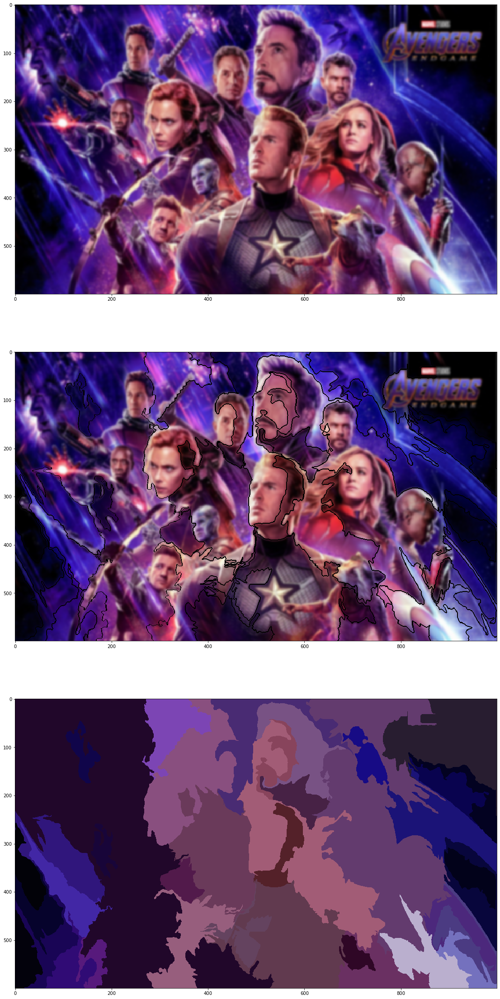

In [9]:
explore_slic_results(10*10, 10.0)

1º Step - Loading image....
2º Step - Image pre-processing
2º Step - SLIC Segmentation
Generated 454 labels
3º Step - Get Segments Mean Intensities
4º Step - SLIC Recolorized image
Final Step - Plotting results :)


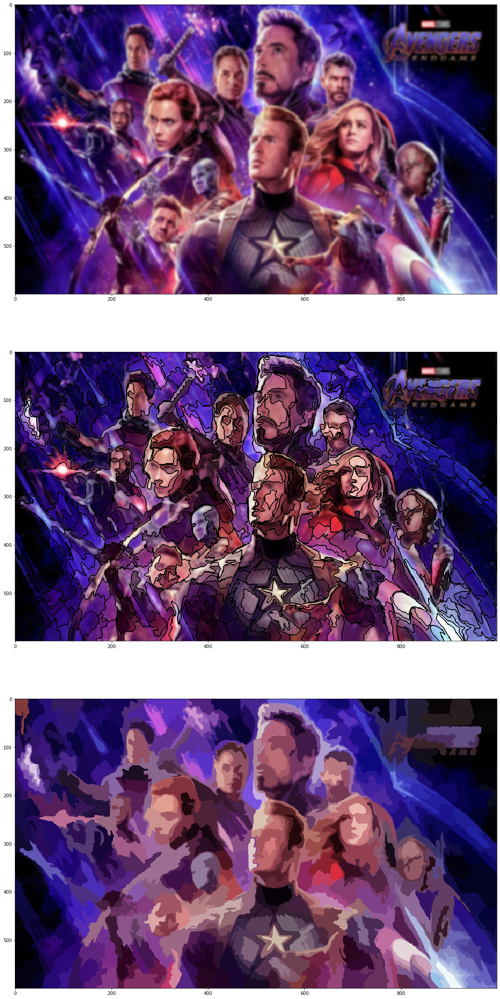

In [10]:
explore_slic_results(24*24, 20.0)

1º Step - Loading image....
2º Step - Image pre-processing
2º Step - SLIC Segmentation
Generated 576 labels
3º Step - Get Segments Mean Intensities
4º Step - SLIC Recolorized image
Final Step - Plotting results :)


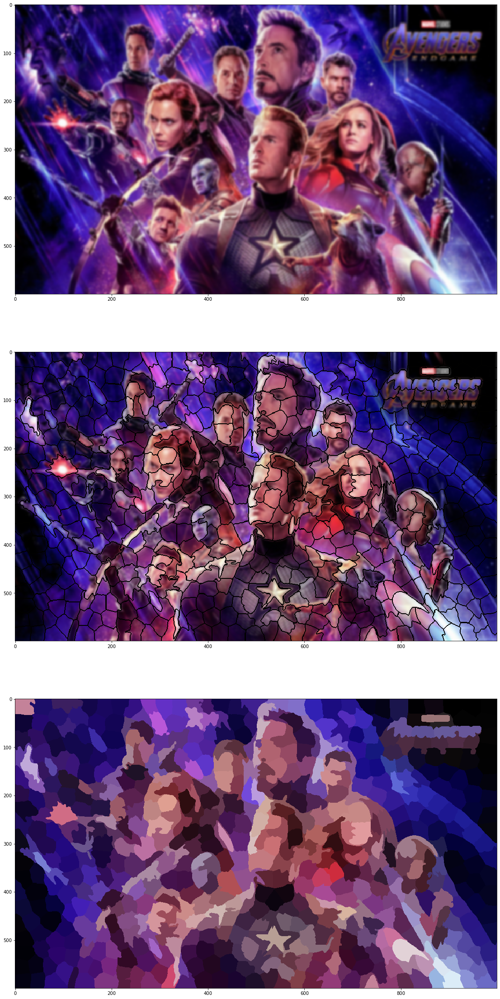

In [15]:
explore_slic_results(24*24, 100.0)

1º Step - Loading image....
2º Step - Image pre-processing
2º Step - SLIC Segmentation
Generated 4133 labels
3º Step - Get Segments Mean Intensities
4º Step - SLIC Recolorized image
Final Step - Plotting results :)


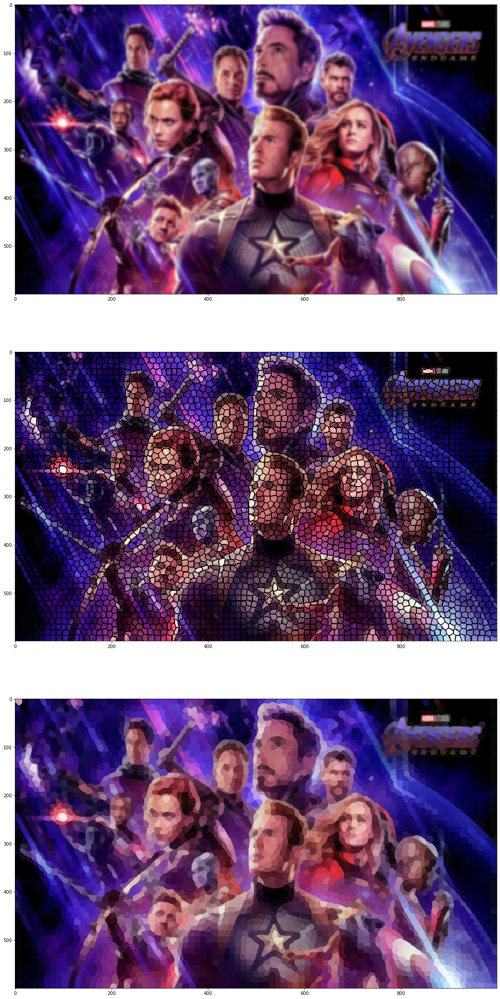

In [16]:
explore_slic_results(64*64, 100.0)

1º Step - Loading image....
2º Step - Image pre-processing
2º Step - SLIC Segmentation
Generated 12089 labels
3º Step - Get Segments Mean Intensities
4º Step - SLIC Recolorized image
Final Step - Plotting results :)


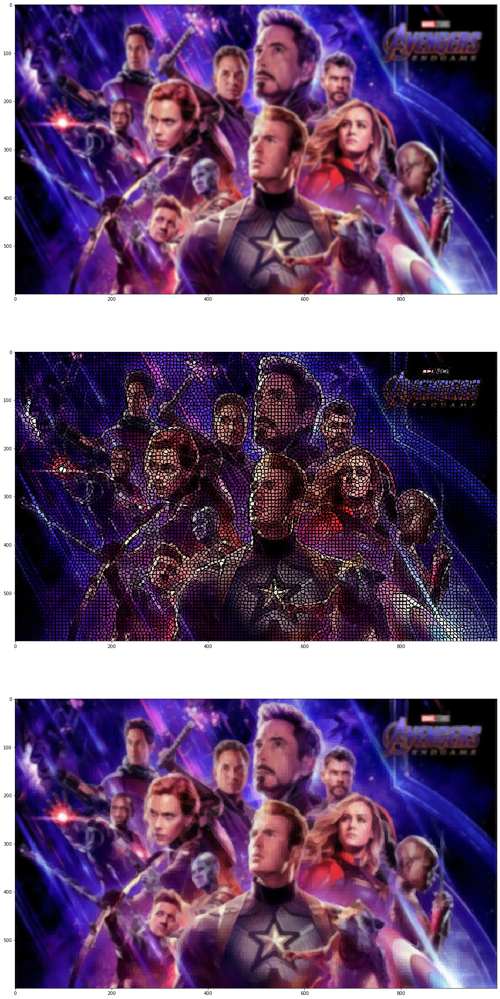

In [20]:
explore_slic_results(112*112, 40.0)

1º Step - Loading image....
2º Step - Image pre-processing
2º Step - SLIC Segmentation
Generated 10726 labels
3º Step - Get Segments Mean Intensities
4º Step - SLIC Recolorized image
Final Step - Plotting results :)


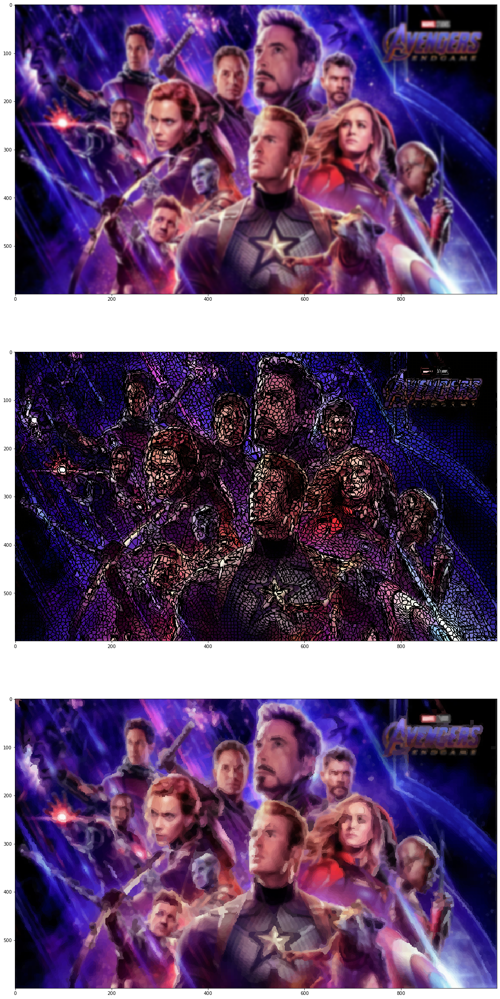

In [21]:
explore_slic_results(112*112, 10.0)

1º Step - Loading image....
2º Step - Image pre-processing
2º Step - SLIC Segmentation
Generated 12288 labels
3º Step - Get Segments Mean Intensities
4º Step - SLIC Recolorized image
Final Step - Plotting results :)


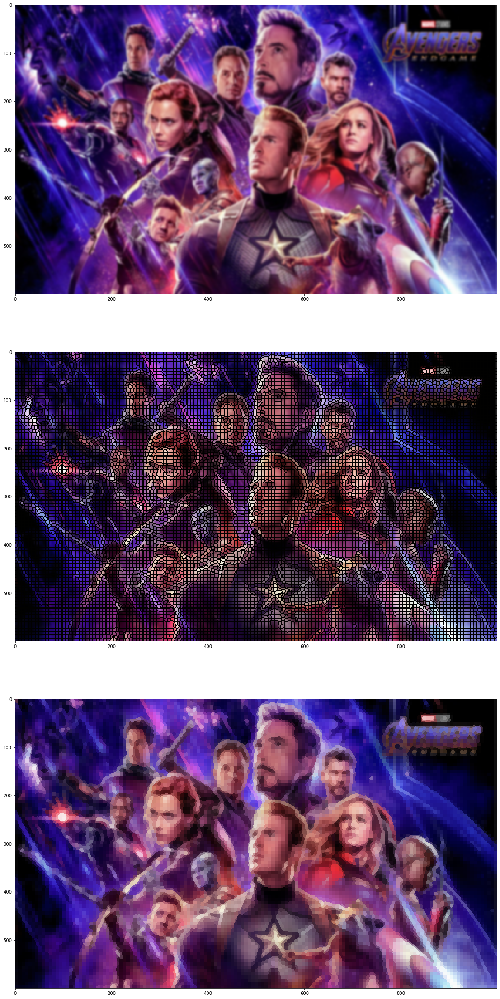

In [17]:
explore_slic_results(112*112, 100.0)

1º Step - Loading image....
2º Step - Image pre-processing
2º Step - SLIC Segmentation
Generated 4150 labels
3º Step - Get Segments Mean Intensities
4º Step - SLIC Recolorized image
Final Step - Plotting results :)


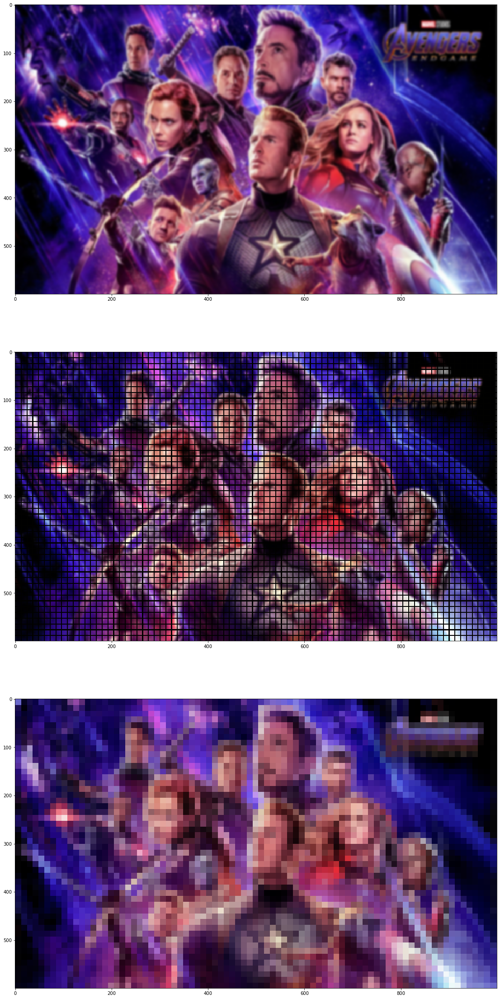

In [18]:
explore_slic_results(64*64, 1000.0)

# Gerador de Pixel Art :)

Usar slic com alta quantidade de segmentos e alto compactness basicamente vira um gerador de pixel arts :P

1º Step - Loading image....
2º Step - Image pre-processing
2º Step - SLIC Segmentation
Generated 12298 labels
3º Step - Get Segments Mean Intensities
4º Step - SLIC Recolorized image
Final Step - Plotting results :)


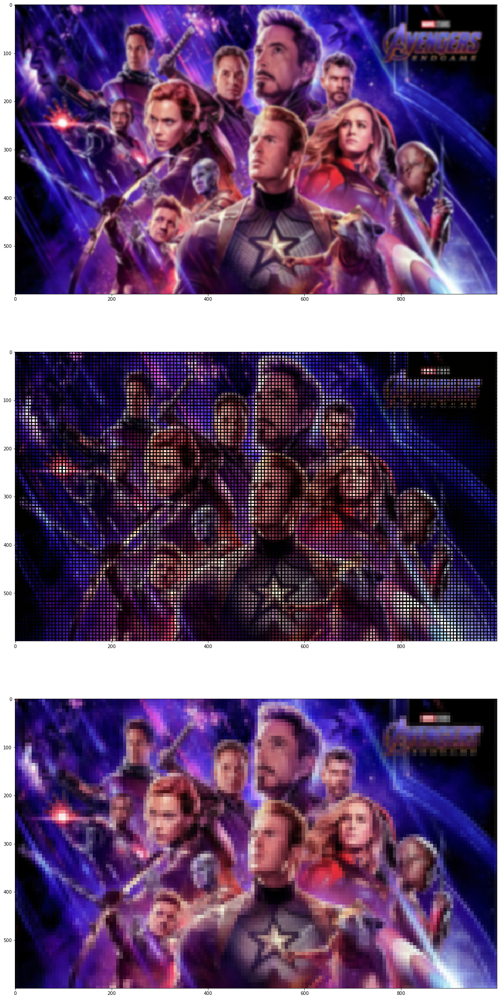

In [22]:
explore_slic_results(112*112, 1000.0)

1º Step - Loading image....
2º Step - Image pre-processing
2º Step - SLIC Segmentation
Generated 66600 labels
3º Step - Get Segments Mean Intensities
4º Step - SLIC Recolorized image
Final Step - Plotting results :)


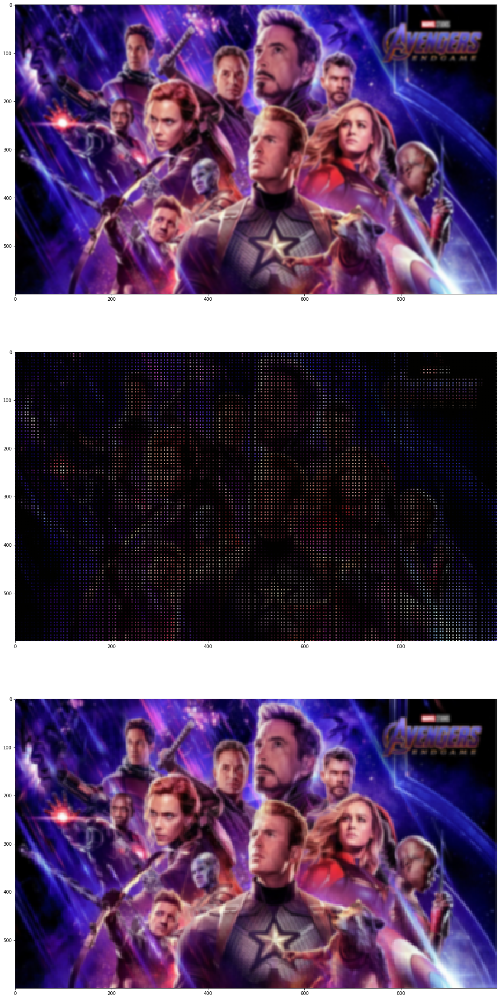

In [23]:
explore_slic_results(300*300, 1000.0)